<a href="https://colab.research.google.com/github/Terry-Migwi/Principal-Component-Analysis/blob/main/Terry_Migwi_PCA_Multivariate_Technique.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### 1. Defining the Question 

#### Specifying the question

The aim of this study is to showcase two applications of Principal Component Analysis.

1.   Visualizing high dimensional data using principal components
2.   Using Principal Component Analysis to speed up Machine Learning Algorithms

#### Defining the metrics for success

This study will be considered successful when: 

*   we can visualize the principal components on a 2D plane
*   PCA helps to improve accuracy of the model or reduce the time used to run the model



#### Understanding the Context

Multivariate analysis is a type of statistical analysis used to analyse more than two variables. Common types of multivariate analysis include but not limited to: 

*   Principal Component Analysis (PCA) which is a multivariate technique for unsupervised learning i.e PCA only needs feature variables. It does not need targets.
*   Linear Discriminant Analysis (LDA) which is a multivariate technique for supervised learning i.e it makes use of the target variable.
*   Factor Analysis

All three techniques above are used for dimensionality reduction. i.e reduce data from a large number of variable to a small number of variables. In the event the data is too much, these techniques are used to reduce it making it easier to examine the data. 

**Advantages of PCA **

*   Removes correlated features - for high dimensional data, it is advisable to remove highly correlated features as they affect the model performance. Finding correlation manually in thousands of features is nearly impossible, frustrating and time consuming. PCA removes correlated features automatically such that the principal components are unrelated to each other. 
*   Improves algorithm performance - the performance of an algorithm could be affected by the number of features. With so many features, the performance drastically degrades hence PCA speeds up algorithms by reducing the number of features.
*   Reduces overfitting - Overfitting mainly occurs when there are too many variables in the dataset thus PCA combats overfitting by reducing the number of variables
*   Improves Visualization - It is difficult to visualize the data in high dimensions. PCA converts a high dimensional data to low dimensional data (2D) so it can be easily visualized.

**Disadvantages of PCA**

*   Independent variables become less interpretable - after performing PCA, original features become principal components which are not easy to interpret.
*   Data standardization is a must before PCA as PCA is affected by scale.
*   Information loss - Although principal components cover maximum variance among the features in a dataset, if the components are not picked carefully, it may miss some information as compared to the original list of features.

#### Recording the Experimental design

The following steps wil be taken in this study:

1.   Importing libraries and loading the dataset
2.   Checking the dataset and the components i.e size, datatypes, missing data e.t.c
3.   Conducting necessary data preparation procedures.
4.   Conducting Exploratory Data Analysis and documenting the findings
5.   Implementing PCA for easier visualization of the dataset
6.   Fitting a logistic regression algorithm to the dataset
7.   Implementing PCA to observe how it affects the performance of the algorithm

 ### 2. Reading the data

In [ ]:
# load google drive

In [1]:
# install sweetviz package
!pip install sweetviz

     |████████████████████████████████| 15.1 MB 6.6 MB/s 


In [2]:
# import necesarry libraries

# for data manipulation
import pandas as pd
import numpy as np

# for visualization
import matplotlib.pyplot as plt
# import seaborn as sns
import sweetviz

# for machine learning
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score


In [3]:
# load the dataset

credit_card_data = pd.read_csv('/content/drive/MyDrive/Moringa School/Terry_Migwi_Work_Assessment/creditcard.csv')

In [4]:
# preview the head of the dataset

credit_card_data.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [ ]:
# preview the tail of the dataset

credit_card_data.tail()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
284802,172786.0,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,4.356170,-1.593105,2.711941,-0.689256,4.626942,-0.924459,1.107641,1.991691,0.510632,-0.682920,1.475829,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0
284803,172787.0,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,-0.975926,-0.150189,0.915802,1.214756,-0.675143,1.164931,-0.711757,-0.025693,-1.221179,-1.545556,0.059616,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0
284804,172788.0,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,-0.484782,0.411614,0.063119,-0.183699,-0.510602,1.329284,0.140716,0.313502,0.395652,-0.577252,0.001396,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0
284805,172788.0,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,-0.399126,-1.933849,-0.962886,-1.042082,0.449624,1.962563,-0.608577,0.509928,1.113981,2.897849,0.127434,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0
284806,172792.0,-0.533413,-0.189733,0.703337,-0.506271,-0.012546,-0.649617,1.577006,-0.414650,0.486180,-0.915427,-1.040458,-0.031513,-0.188093,-0.084316,0.041333,-0.302620,-0.660377,0.167430,-0.256117,0.382948,0.261057,0.643078,0.376777,0.008797,-0.473649,-0.818267,-0.002415,0.013649,217.00,0


In [ ]:
# check size of the dataset
credit_card_data.shape

display("The dataset has {} records and {} features" .format(credit_card_data.shape[0], credit_card_data.shape[1]))

'The dataset has 284807 records and 31 features'

In [ ]:
# obtaining information about the dataset
credit_card_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

All the variables are of numerical datatypes which means the data is already in good shape for perfoming PCA

### Data Relevance

The dataset contains 30 columns and 284807 records. The dataset has relatively high dimensioanlity hence it is relevant for our research question. Which is to reduce dimensionality of the data using PCA. The data has however been anonymized due to the critical information contained in credit cards. This is no an issue for this project because we are not necessarily interested in the column names.

#### Check for completeness

In [ ]:
# check for missing values

credit_card_data.isnull().sum()

The dataset has no missing data

#### Check for consistency

In [ ]:
# check for duplicate records
credit_card_data[credit_card_data.duplicated()]

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
33,26.0,-0.529912,0.873892,1.347247,0.145457,0.414209,0.100223,0.711206,0.176066,-0.286717,-0.484688,0.872490,0.851636,-0.571745,0.100974,-1.519772,-0.284376,-0.310524,-0.404248,-0.823374,-0.290348,0.046949,0.208105,-0.185548,0.001031,0.098816,-0.552904,-0.073288,0.023307,6.14,0
35,26.0,-0.535388,0.865268,1.351076,0.147575,0.433680,0.086983,0.693039,0.179742,-0.285642,-0.482474,0.871800,0.853447,-0.571822,0.102252,-1.519991,-0.285912,-0.309633,-0.403902,-0.823743,-0.283264,0.049526,0.206537,-0.187108,0.000753,0.098117,-0.553471,-0.078306,0.025427,1.77,0
113,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
114,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
115,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282987,171288.0,1.912550,-0.455240,-1.750654,0.454324,2.089130,4.160019,-0.881302,1.081750,1.022928,0.005356,-0.541998,0.745036,-0.375165,-0.068227,-0.795939,-0.497901,-0.134224,-1.004958,0.086074,-0.207620,-0.524067,-1.337510,0.473943,0.616683,-0.283548,-1.084843,0.073133,-0.036020,11.99,0
283483,171627.0,-1.464380,1.368119,0.815992,-0.601282,-0.689115,-0.487154,-0.303778,0.884953,0.054065,-0.828015,-1.192581,0.944989,1.372532,-0.036493,-0.208747,0.320086,-0.204910,-0.024821,-0.468859,0.031950,0.287217,0.947825,-0.218773,0.082926,0.044127,0.639270,0.213565,0.119251,6.82,0
283485,171627.0,-1.457978,1.378203,0.811515,-0.603760,-0.711883,-0.471672,-0.282535,0.880654,0.052808,-0.830603,-1.191774,0.942870,1.372621,-0.037988,-0.208490,0.321883,-0.205951,-0.025225,-0.468427,0.023667,0.284205,0.949659,-0.216949,0.083250,0.044944,0.639933,0.219432,0.116772,11.93,0
284191,172233.0,-2.667936,3.160505,-3.355984,1.007845,-0.377397,-0.109730,-0.667233,2.309700,-1.639306,-1.449823,-0.508930,0.600035,-0.627313,1.017499,-0.887384,0.420096,1.856497,1.315099,1.096112,-0.821707,0.391483,0.266536,-0.079853,-0.096395,0.086719,-0.451128,-1.183743,-0.222200,55.66,0


The dataset seems to have duplicated records. he time column portrays duplictaed records. This is possible because credit card transactions can happen at the same time. We will therefore drop the time column as it is not important for our analysis. 

In [6]:
# drop the time column

credit_data = credit_card_data.drop(labels='Time', axis = 1, inplace = False)

In [7]:
# confirm changes have been effected
credit_data.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


#### Check for Outliers

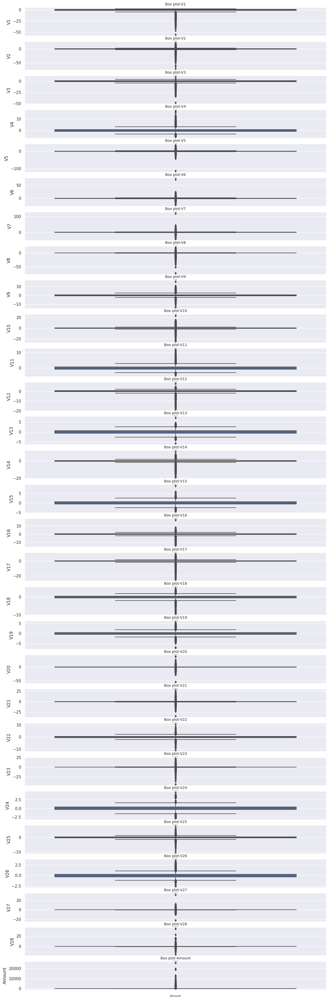

In [ ]:
# using boxplots to check for outliers

columns = ['V1',	'V2',	'V3',	'V4',	'V5',	'V6',	'V7',	'V8',	'V9',	'V10',	'V11',	'V12',
           'V13',	'V14',	'V15',	'V16',	'V17',	'V18',	'V19',	'V20',	'V21',	'V22',
           'V23',	'V24',	'V25',	'V26',	'V27',	'V28',	'Amount']

fig, ax = plt.subplots(len(columns), figsize = (15, 50))

for i, col_val in enumerate(columns):

  sns.boxplot(y= credit_data[col_val], ax=ax[i])
  ax[i].set_title('Box plot-{}'.format(col_val), fontsize=10)
  ax[i].set_xlabel(col_val, fontsize=8)

plt.show()

**Observations**

*   Most variables are tending towards the negative side
*   Amount variable has the largest scale range. Hence, need to scale the data
*   We can observe a few outliers but we will not remove them.
*   The outlier points are both at the positive and negative side

### Exploratory Data Analysis

We will use sweetviz, a package that performs univariate analysis of all the columns in the dataframe at once. It will then generate a report.

                                             |          | [  0%]   00:00 -> (? left)


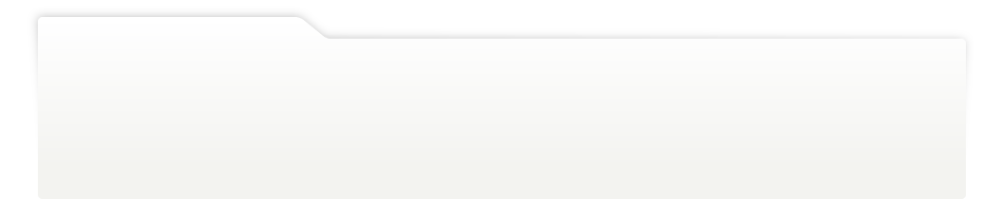
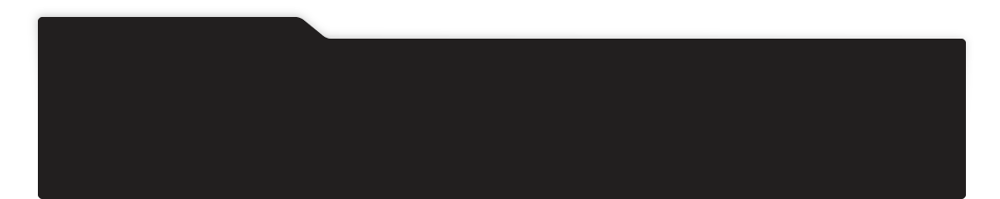
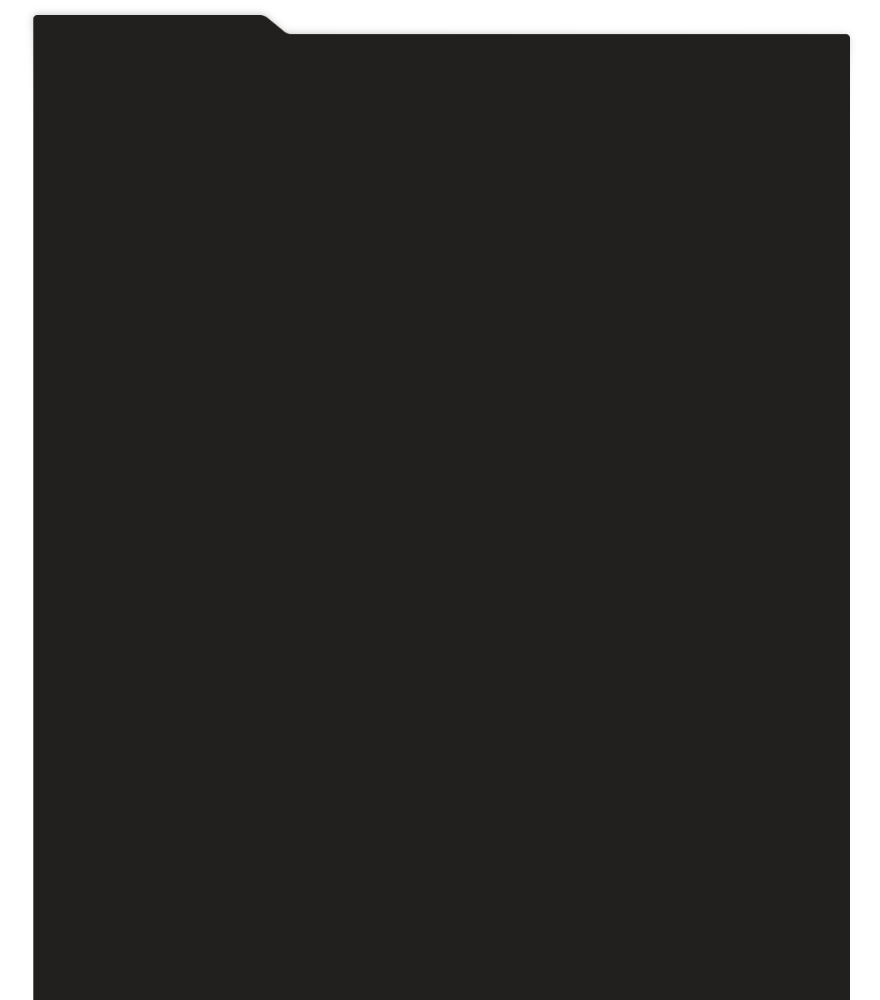
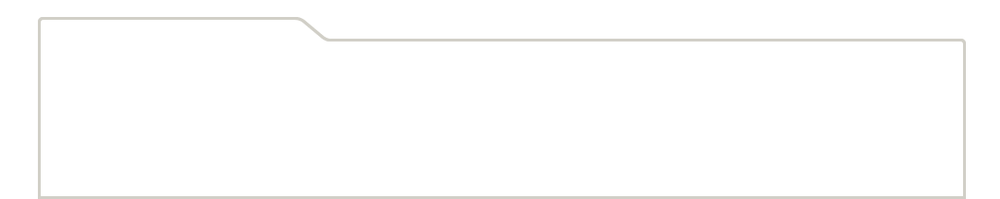
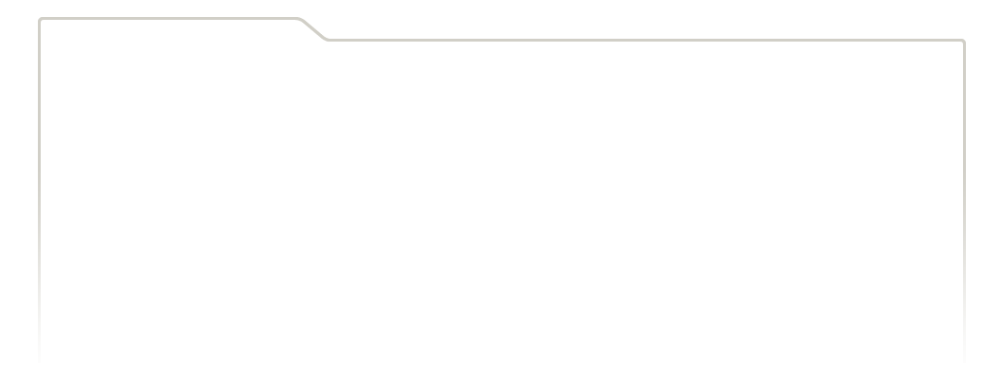
...
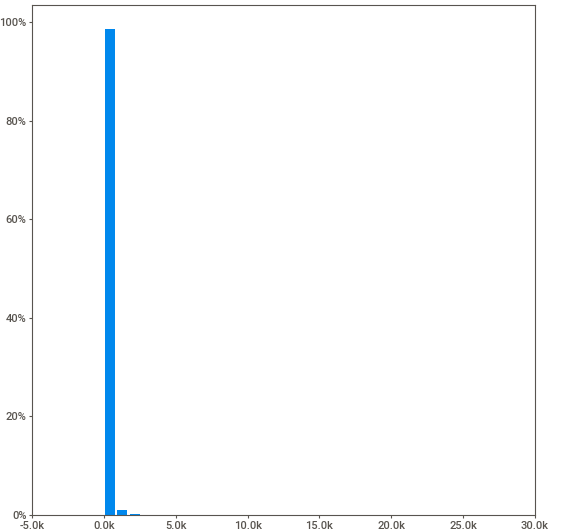
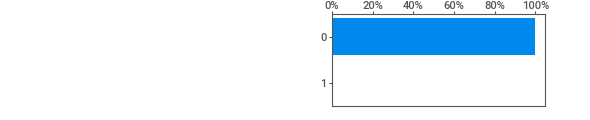
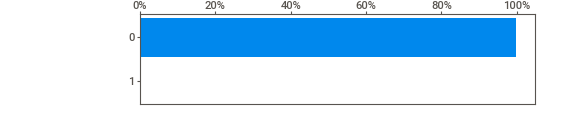
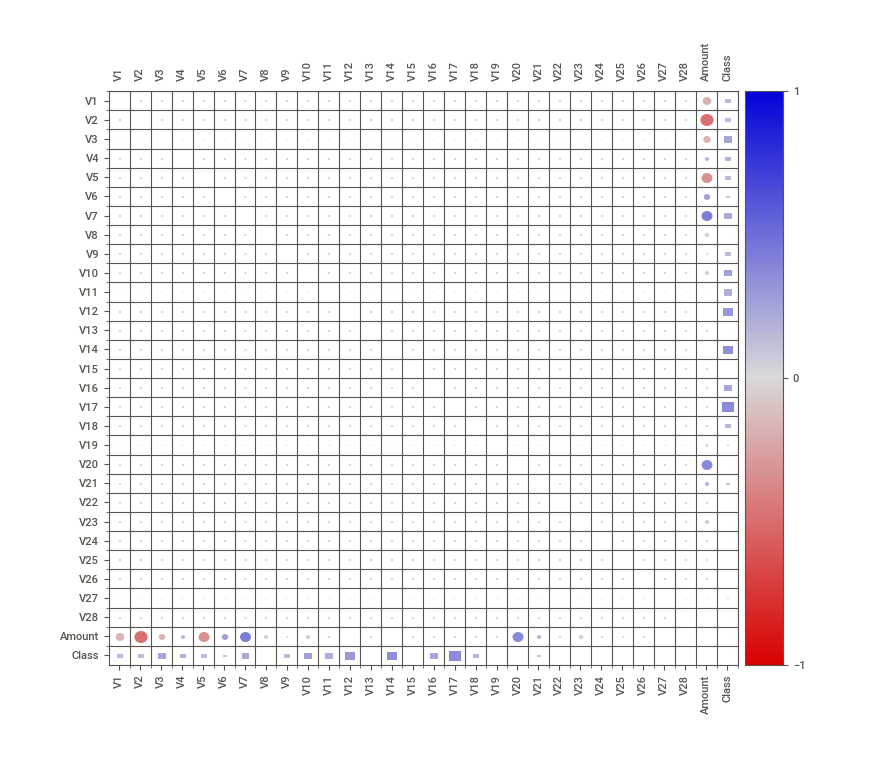
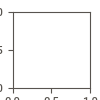

In [ ]:
# use sweetviz to generate the report
report = sweetviz.analyze(credit_data_df)
report.show_notebook()

**Observations from the Report**

*   There are no zero values in the dataset. However, all the variables have different a scale range with most revolving around zero. 
*   The target variable has two categories. 0 for non-fraudulent transcation and 1 for a fraudulent transaction. The non-fradulent transactions are more than the fraudulent ones.
*   The variables are not highly correlated. The amount variable shows some correlation with other independent variables.
*   Most of the variables seem to follow a normal distribution. Some are skewed to the left.


In [ ]:
# obtain statistical summary of the dataset
credit_data.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,3.919560e-15,5.688174e-16,-8.769071e-15,2.782312e-15,-1.552563e-15,2.010663e-15,-1.694249e-15,-1.927028e-16,-3.137024e-15,1.768627e-15,9.170318e-16,-1.810658e-15,1.693438e-15,1.479045e-15,3.482336e-15,1.392007e-15,-7.528491e-16,4.328772e-16,9.049732e-16,5.085503e-16,1.537294e-16,7.959909e-16,5.367590e-16,4.458112e-15,1.453003e-15,1.699104e-15,-3.660161e-16,-1.206049e-16,88.349619,0.001727
std,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,1.088850e+00,1.020713e+00,9.992014e-01,9.952742e-01,9.585956e-01,9.153160e-01,8.762529e-01,8.493371e-01,8.381762e-01,8.140405e-01,7.709250e-01,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,-2.458826e+01,-4.797473e+00,-1.868371e+01,-5.791881e+00,-1.921433e+01,-4.498945e+00,-1.412985e+01,-2.516280e+01,-9.498746e+00,-7.213527e+00,-5.449772e+01,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,-5.354257e-01,-7.624942e-01,-4.055715e-01,-6.485393e-01,-4.255740e-01,-5.828843e-01,-4.680368e-01,-4.837483e-01,-4.988498e-01,-4.562989e-01,-2.117214e-01,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,-9.291738e-02,-3.275735e-02,1.400326e-01,-1.356806e-02,5.060132e-02,4.807155e-02,6.641332e-02,-6.567575e-02,-3.636312e-03,3.734823e-03,-6.248109e-02,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,4.539234e-01,7.395934e-01,6.182380e-01,6.625050e-01,4.931498e-01,6.488208e-01,5.232963e-01,3.996750e-01,5.008067e-01,4.589494e-01,1.330408e-01,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,2.374514e+01,1.201891e+01,7.848392e+00,7.126883e+00,1.052677e+01,8.877742e+00,1.731511e+01,9.253526e+00,5.041069e+00,5.591971e+00,3.942090e+01,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


**Conclusions**

*   The mean value of most of the variables is tending towards 0.
*   All the variables have a relatively low standard deviation, tending towards 1.
*   With a mean value of almost 0 and standard deviation of almost 1, the dataset portrays that of a normal distribution.





#### Bivariate Analysis

In [35]:
# crete a new df without the target variable 
credit_data_minus_target = credit_data.drop(labels='Class', axis = 1, inplace = False)

In [ ]:
# import seaborn as sns
# sns.set_theme(style = 'darkgrid')

# pairplot
sns.pairplot(credit_data_minus_target)

In [ ]:
# correlation plots

credit_data.corr()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
V1,1.000000e+00,4.697350e-17,-1.424390e-15,1.755316e-17,6.391162e-17,2.398071e-16,1.991550e-15,-9.490675e-17,2.169581e-16,7.433820e-17,2.438580e-16,2.422086e-16,-2.115458e-16,9.352582e-16,-3.252451e-16,6.308789e-16,-5.011524e-16,2.870125e-16,1.818128e-16,1.036959e-16,-1.755072e-16,7.477367e-17,9.808705e-16,7.354269e-17,-9.805358e-16,-8.621897e-17,3.208233e-17,9.820892e-16,-0.227709,-0.101347
V2,4.697350e-17,1.000000e+00,2.512175e-16,-1.126388e-16,-2.039868e-16,5.024680e-16,3.966486e-16,-4.413984e-17,-5.728718e-17,-4.782388e-16,9.468995e-16,-6.588252e-16,3.854521e-16,-2.541036e-16,2.831060e-16,4.934097e-17,-9.883008e-16,2.636654e-16,9.528280e-17,-9.309954e-16,8.444409e-17,2.500830e-16,1.059562e-16,-8.142354e-18,-4.261894e-17,2.601622e-16,-4.478472e-16,-3.676415e-16,-0.531409,0.091289
V3,-1.424390e-15,2.512175e-16,1.000000e+00,-3.416910e-16,-1.436514e-15,1.431581e-15,2.168574e-15,3.433113e-16,-4.233770e-16,6.289267e-16,-5.501758e-17,2.206522e-16,-6.883375e-16,4.271336e-16,1.122756e-16,1.183364e-15,4.576619e-17,5.427965e-16,2.576773e-16,-9.429297e-16,-2.971969e-17,4.648259e-16,2.115206e-17,-9.351637e-17,4.771164e-16,6.521501e-16,6.239832e-16,7.726948e-16,-0.210880,-0.192961
V4,1.755316e-17,-1.126388e-16,-3.416910e-16,1.000000e+00,-1.940929e-15,-2.712659e-16,1.556330e-16,5.195643e-16,3.859585e-16,6.055490e-16,-2.083600e-16,-5.657963e-16,-1.506129e-16,-8.522435e-17,-1.507718e-16,-6.939204e-16,-4.397925e-16,1.493667e-16,-2.656938e-16,-3.223123e-16,-9.976950e-17,2.099922e-16,6.002528e-17,2.229738e-16,5.394585e-16,-6.179751e-16,-6.403423e-17,-5.863664e-17,0.098732,0.133447
V5,6.391162e-17,-2.039868e-16,-1.436514e-15,-1.940929e-15,1.000000e+00,7.926364e-16,-4.209851e-16,7.589187e-16,4.205206e-16,-6.601716e-16,7.342759e-16,3.761033e-16,-9.578659e-16,-3.634803e-16,-5.132620e-16,-3.517076e-16,1.425729e-16,1.109525e-15,-3.138234e-16,2.076048e-16,-1.368701e-16,5.060029e-16,1.637596e-16,-9.286095e-16,5.625102e-16,9.144690e-16,4.465960e-16,-3.299167e-16,-0.386356,-0.094974
V6,2.398071e-16,5.024680e-16,1.431581e-15,-2.712659e-16,7.926364e-16,1.000000e+00,1.429426e-16,-1.707421e-16,1.114447e-16,2.850776e-16,4.865799e-16,2.140589e-16,-2.268061e-16,3.452801e-16,-6.368111e-18,-2.477917e-16,3.567582e-16,2.811474e-16,2.717167e-16,1.898638e-16,-1.575903e-16,-3.362902e-16,-7.232186e-17,-1.261867e-15,1.081933e-15,-2.378414e-16,-2.623818e-16,4.813155e-16,0.215981,-0.043643
V7,1.991550e-15,3.966486e-16,2.168574e-15,1.556330e-16,-4.209851e-16,1.429426e-16,1.000000e+00,-8.691834e-17,7.933251e-16,3.043333e-17,-1.084105e-15,1.510045e-15,-9.892325e-17,-1.729462e-16,1.936832e-17,2.893672e-16,1.149692e-15,-1.116789e-16,-2.874017e-16,1.744242e-16,1.938604e-16,-1.058131e-15,2.327911e-16,-2.589727e-17,1.174169e-15,-7.334507e-16,-5.886825e-16,-6.836764e-17,0.397311,-0.187257
V8,-9.490675e-17,-4.413984e-17,3.433113e-16,5.195643e-16,7.589187e-16,-1.707421e-16,-8.691834e-17,1.000000e+00,2.900829e-16,9.051847e-17,1.954747e-16,-6.266057e-17,-2.382948e-16,-1.131098e-16,2.021491e-16,5.027192e-16,-3.508777e-16,-4.093852e-16,-5.339821e-16,-1.095534e-16,-2.412439e-16,5.475559e-16,3.897104e-16,-1.802967e-16,-1.390791e-16,-1.209975e-16,1.733633e-16,-4.484325e-16,-0.103079,0.019875
V9,2.169581e-16,-5.728718e-17,-4.233770e-16,3.859585e-16,4.205206e-16,1.114447e-16,7.933251e-16,2.900829e-16,1.000000e+00,-2.771761e-16,4.682341e-16,-2.445230e-15,-2.650351e-16,2.343317e-16,-1.588105e-15,-3.251906e-16,6.535992e-16,1.203843e-16,1.120752e-16,-4.340941e-16,4.578389e-17,2.871855e-17,5.929286e-16,-2.346385e-16,1.099645e-15,-1.388725e-15,-2.287414e-16,9.146779e-16,-0.044246,-0.097733
V10,7.433820e-17,-4.782388e-16,6.289267e-16,6.055490e-16,-6.601716e-16,2.850776e-16,3.043333e-17,9.051847e-17,-2.771761e-16,1.000000e+00,2.624448e-16,1.439907e-15,-8.853582e-16,2.622513e-16,7.615272e-16,-1.705923e-15,3.674182e-15,3.986710e-16,2.663038e-17,-1.141888e-15,8.089504e-16,-6.707598e-16

The dataset does not exhibit close correlations. This implies our model will not have irrelevant information.

### Multivariate Analysis - Principal Component Analysis 

#### Using PCA for Visualization 
- Converting high dimensional data to principal components for better visualization
- Standardizing data for PCA. PCA is effeted by scale hence we will use sklearn's standardization(mean = 0, variance = 1)

In [39]:
# separate feature variables and the target variable 

features = ['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount']

# Separating out the features
X = credit_data.loc[:, features].values

# Separating out the target
y = credit_data.loc[:,['Class']].values

In [40]:
# Standardize the feature variables using sklearn's standardscaler method

X = StandardScaler().fit_transform(X)

In [41]:
# view standardized values

X

array([[-0.69424232, -0.04407492,  1.6727735 , ...,  0.33089162,
        -0.06378115,  0.24496426],
       [ 0.60849633,  0.16117592,  0.1097971 , ..., -0.02225568,
         0.04460752, -0.34247454],
       [-0.69350046, -0.81157783,  1.16946849, ..., -0.13713686,
        -0.18102083,  1.16068593],
       ...,
       [ 0.98002374, -0.18243372, -2.14320514, ...,  0.01103672,
        -0.0804672 , -0.0818393 ],
       [-0.12275539,  0.32125034,  0.46332013, ...,  0.26960398,
         0.31668678, -0.31324853],
       [-0.27233093, -0.11489898,  0.46386564, ..., -0.00598394,
         0.04134999,  0.51435531]])

In [42]:
# convert standardized values in array to a dataframe

scaled_credit_data = pd.DataFrame(X, columns = ['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11','V12', 'V13', 'V14', 'V15', 
                                                'V16', 'V17', 'V18', 'V19', 'V20', 'V21','V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount'])

scaled_credit_data.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
0,-0.694242,-0.044075,1.672773,0.973366,-0.245117,0.347068,0.193679,0.082637,0.331128,0.083386,-0.540407,-0.618296,-0.996099,-0.324610,1.604014,-0.536833,0.244863,0.030770,0.496282,0.326118,-0.024923,0.382854,-0.176911,0.110507,0.246585,-0.392170,0.330892,-0.063781,0.244964
1,0.608496,0.161176,0.109797,0.316523,0.043483,-0.061820,-0.063700,0.071253,-0.232494,-0.153350,1.580003,1.066089,0.491418,-0.149982,0.694360,0.529434,-0.135170,-0.218763,-0.179086,-0.089611,-0.307377,-0.880077,0.162201,-0.561131,0.320694,0.261069,-0.022256,0.044608,-0.342475
2,-0.693500,-0.811578,1.169468,0.268231,-0.364572,1.351454,0.639776,0.207373,-1.378675,0.190700,0.611830,0.066137,0.720700,-0.173114,2.562906,-3.298235,1.306868,-0.144790,-2.778561,0.680975,0.337632,1.063358,1.456320,-1.138092,-0.628537,-0.288447,-0.137137,-0.181021,1.160686
3,-0.493325,-0.112169,1.182516,-0.609727,-0.007469,0.936150,0.192071,0.316018,-1.262503,-0.050468,-0.221892,0.178371,0.510169,-0.300360,-0.689837,-1.209296,-0.805445,2.345305,-1.514205,-0.269855,-0.147443,0.007267,-0.304777,-1.941027,1.241904,-0.460217,0.155396,0.186189,0.140534
4,-0.591330,0.531541,1.021412,0.284655,-0.295015,0.071999,0.479302,-0.226510,0.744326,0.691625,-0.806147,0.538627,1.352244,-1.168034,0.191323,-0.515205,-0.279081,-0.045569,0.987037,0.529939,-0.012839,1.100011,-0.220123,0.233250,-0.395202,1.041611,0.543620,0.651816,-0.073403


#### PCA projection to 2D

In [43]:
# implementing sklearn's pca
# we will work with six pricipal components
pca = PCA(n_components=6)

# instantiating the pca
principalComponents = pca.fit_transform(X)

In [44]:
# create a dataframe with the six principal components
principal_credit_data = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2', 'principal component 3', 
                          'principal component 4', 'principal component 5', 'principal component 6'])

# preview
principal_credit_data.head()

,principal component 1,principal component 2,principal component 3,principal component 4,principal component 5,principal component 6
0,0.287762,0.646212,-0.525135,0.544929,0.168777,0.499465
1,-0.500735,-0.842979,0.307061,-0.108178,0.467227,0.228275
2,1.731472,1.606614,-0.262525,1.886978,-0.440675,1.163802
3,0.233802,0.574160,1.464011,-0.169252,0.193595,0.791174
4,-0.060903,1.491000,-0.131859,1.403160,-0.447368,0.465481


In [45]:
# create the final df of the principal components and the class

final_credit_data = pd.concat([principal_credit_data, credit_data[['Class']]], axis = 1)

# preview the head
final_credit_data.head()

,principal component 1,principal component 2,principal component 3,principal component 4,principal component 5,principal component 6,Class
0,0.287762,0.646212,-0.525135,0.544929,0.168777,0.499465,0
1,-0.500735,-0.842979,0.307061,-0.108178,0.467227,0.228275,0
2,1.731472,1.606614,-0.262525,1.886978,-0.440675,1.163802,0
3,0.233802,0.574160,1.464011,-0.169252,0.193595,0.791174,0
4,-0.060903,1.491000,-0.131859,1.403160,-0.447368,0.465481,0


#### Visualize 2D Projection

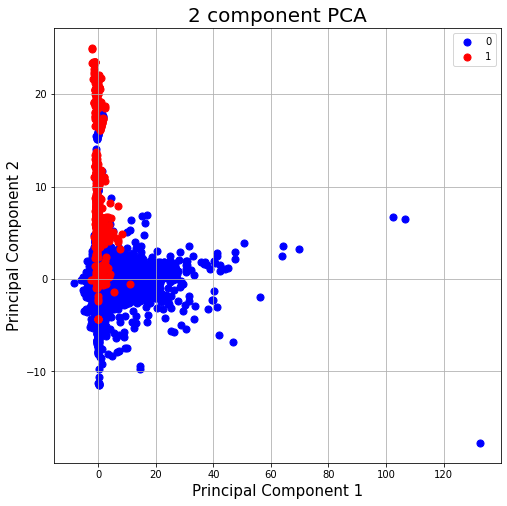

In [48]:
# plot a 2D Graph to visualize principal components 1 and 2

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = [0, 1]
colors = ['b', 'r']

for target, color in zip(targets,colors):
    indicesToKeep = final_credit_data['Class'] == target
    ax.scatter(final_credit_data.loc[indicesToKeep, 'principal component 1']
              , final_credit_data.loc[indicesToKeep, 'principal component 2']
              , c = color    
              , s = 50)
ax.legend(targets)
ax.grid()

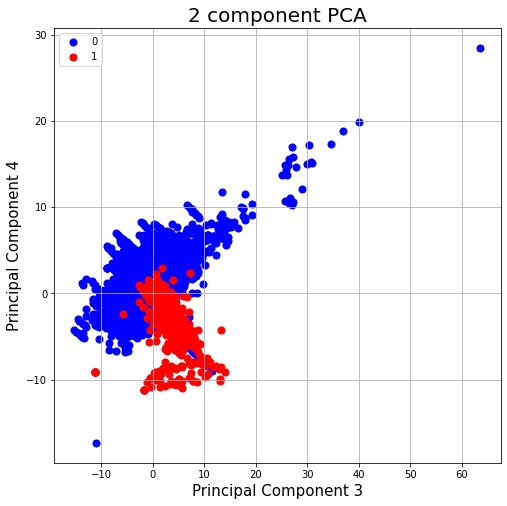

In [46]:
# plot a 2D Graph to visualize principal components 3 and 4

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 3', fontsize = 15)
ax.set_ylabel('Principal Component 4', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = [0, 1]
colors = ['b', 'r']

for target, color in zip(targets,colors):
    indicesToKeep = final_credit_data['Class'] == target
    ax.scatter(final_credit_data.loc[indicesToKeep, 'principal component 3']
              , final_credit_data.loc[indicesToKeep, 'principal component 4']
              , c = color    
              , s = 50)
ax.legend(targets)
ax.grid()

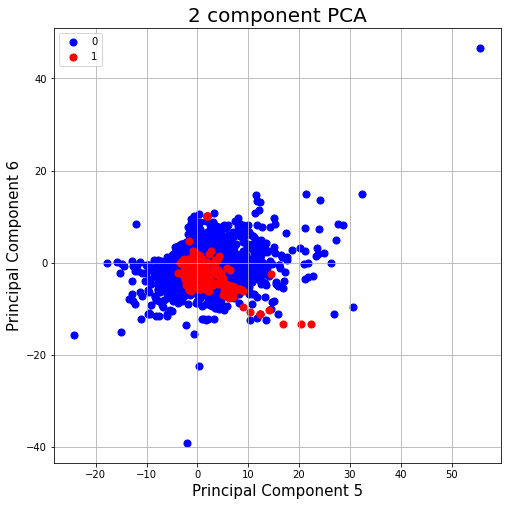

In [47]:
# plot a 2D Graph to visualize principal components 5 and 6

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 5', fontsize = 15)
ax.set_ylabel('Principal Component 6', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = [0, 1]
colors = ['b', 'r']

for target, color in zip(targets,colors):
    indicesToKeep = final_credit_data['Class'] == target
    ax.scatter(final_credit_data.loc[indicesToKeep, 'principal component 5']
              , final_credit_data.loc[indicesToKeep, 'principal component 6']
              , c = color    
              , s = 50)
ax.legend(targets)
ax.grid()

From the above graphs, we note that the two classes are well separated from each other. Using Principal components to project 30 dimensions on a 2D plane has clearly made it easier to visualize our high dimensional data. We also observe that the data has been well clustered into two distinct classes. 

We can therefore comfortably say our first objective has been achieved.

#### Scree plot

- We will use a scree plot to determine how many principle components to keep.

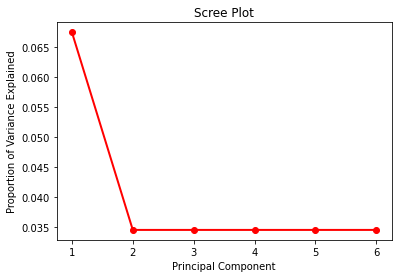

In [49]:
# scree plot

PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

We observe an elbow at the second principal component then a straight line to the last principal component. This plot implies first principal component has the most information.

#### Threshold of Variance explained.

Variance in this case refers to the amount of information the principal components hold. 

In [50]:
# explained variance

# pca.explained_variance_ratio_

print ("Proportion of Variance Explained : ", pca.explained_variance_ratio_)     
out_sum = np.cumsum(pca.explained_variance_ratio_) 

print('\n')
print ("Cumulative Prop. Variance Explained: ", out_sum)

Proportion of Variance Explained :  [0.06748089 0.03448276 0.03448276 0.03448276 0.03448276 0.03448276]


Cumulative Prop. Variance Explained:  [0.06748089 0.10196365 0.13644641 0.17092917 0.20541192 0.23989468]


In our case, we hold that all six principal components hold at most 24% variance. This is not much hence for our model we will work with at least 70% variance. 

#### PCA to improve Machine Learning Algorithms

In [7]:
# step 1: Pre-processing
# Pre-processing entails seprating the feature set and the corresponding labels

X = credit_data.drop('Class', 1)
y = credit_data['Class']

In [8]:
# step 2: Split the data into train and test set using sklearn's train_test_split

# reserve 20% of the data for validation
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [9]:
# step 3: Scale the data using sklearn's standard scalar

sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [10]:
# step 4: Fit a logistic regression model before pca

# instantiate logistic regression from sklearn

%%time
LogReg = LogisticRegression()
LogReg.fit(X_train, y_train) 

# making predictions
y_pred = LogReg.predict(X_test)


CPU times: user 5.42 s, sys: 1.72 s, total: 7.15 s
Wall time: 3.75 s


In [11]:
# perform model evaluation using the confusion matrix and accuracy

print(confusion_matrix(y_test, y_pred))

# accuracy
print('Accuracy' , accuracy_score(y_test, y_pred))


[[56852     9]
 [   37    64]]
Accuracy 0.9991924440855307


Before applying PCA, we get an accuracy of 0.999 which is almost 100%. This implies the model could be overfit.

In [15]:
# step 5: apply pca with 90% variance retained

# specify 90% varaince
pca_variance_90 = PCA(.90)

X_train = pca_variance_90.fit_transform(X_train)
X_test = pca_variance_90.transform(X_test)

In [16]:
# fit a logistic regression after pca

%%time

LogReg2 = LogisticRegression()
LogReg2.fit(X_train, y_train)

# predictions
y_pred_90 = LogReg2.predict(X_test)

CPU times: user 2.97 s, sys: 1.21 s, total: 4.18 s
Wall time: 2.19 s


In [17]:
# evaluate the model

cm_variance_90 = confusion_matrix(y_test, y_pred_90)
print(cm_variance_90)
print('Accuracy' , accuracy_score(y_test, y_pred_90))

[[56854     7]
 [   63    38]]
Accuracy 0.9987711105649381


In [18]:
# find out how many number of components accumulate to 90% of variance
pca_variance_90.n_components_

25

In [19]:
# step 6: apply pca with 70% variance retained

# specify 70% varaince
pca_variance_70 = PCA(.70)

X_train = pca_variance_70.fit_transform(X_train)
X_test = pca_variance_70.transform(X_test)

In [20]:
# fit a logistic regression after pca

%%time

LogReg3 = LogisticRegression()
LogReg3.fit(X_train, y_train)

# predictions
y_pred_70 = LogReg3.predict(X_test)

CPU times: user 2.1 s, sys: 826 ms, total: 2.93 s
Wall time: 1.52 s


In [21]:
# evaluate the model

cm_variance_70 = confusion_matrix(y_test, y_pred_70)
print(cm_variance_70)
print('Accuracy' , accuracy_score(y_test, y_pred_70))

[[56856     5]
 [   70    31]]
Accuracy 0.9986833327481479


In [23]:
# find out how many number of components accumulate to 70% of variance
pca_variance_70.n_components_

18

**Observation:**

The accuracy of the Logistic Regression model dropped from 0.99919 to 0.987 after implementing pca. Further, reducing the variation of the principal componnets still reduces the accuracy. Therefore, pca helped to reduce overfitting of the model.  

**Conclusion:** 

From the above, PCA has proved useful while visualizing high dimensional data and improving Machine Learning Algorithms.  